In [2009]:
import yfinance as yf
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [2010]:
#Extracting stock dat from yahoo finance sector wise for 5 sectors
from datetime import datetime
time_duration = 269
dateList = []
datelist = pd.bdate_range(end=datetime.today(), periods=time_duration).tolist()
start_date = datelist[0].date()
end_date = datelist[-1].date()
bank = ['AXISBANK.NS','ICICIBANK.NS','HDFCBANK.NS','KOTAKBANK.NS','INDUSINDBK.NS','PNB.NS','BANKINDIA.NS','CANBK.NS','IOB.NS','BANKBARODA.NS']
pharma = ['PFIZER.NS','SANOFI.NS',"DRREDDY.NS","ASTRAZEN.NS",'ABBOTINDIA.NS']
engg = ['LTTS.NS','BEL.NS','KENNAMET.NS','ALPHAGEO.NS']
power = ['POWERGRID.NS','TORNTPOWER.NS','SWSOLAR.NS','ADANITRANS.NS','IEX.NS']
IT = ['INFY.NS','LTI.NS','OFSS.NS','TCS.NS']
stocks = bank + pharma + engg + power + IT
data = pd.DataFrame()
dfs = []

for stk in stocks:
    s1 = yf.download(stk,start=start_date,end=end_date)
    s1["stock"] = [stk for i in range(s1.shape[0])]
    dfs.append(s1)
data = pd.concat([df for df in dfs], ignore_index=True)

[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%***********************]  1 of 1 completed
[*********************100%********

In [2011]:
#data is the initial data file with ohlc as columns and each stock's prices over a year one after another as rows
data.head()

,Open,High,Low,Close,Adj Close,Volume,stock
0,697.000000,697.549988,680.500000,682.950012,682.950012,12015623,AXISBANK.NS
1,685.099976,689.349976,673.500000,678.200012,678.200012,5677087,AXISBANK.NS
2,674.000000,676.750000,658.900024,661.150024,661.150024,8753540,AXISBANK.NS
3,664.900024,668.599976,640.099976,663.900024,663.900024,17115901,AXISBANK.NS
4,658.799988,658.799988,641.450012,645.700012,645.700012,8461431,AXISBANK.NS


In [2060]:
data.shape

(7056, 8)

In [2013]:
data.describe()

,Open,High,Low,Close,Adj Close,Volume
count,7056.000000,7056.000000,7056.000000,7056.000000,7056.000000,7.056000e+03
mean,1705.181362,1733.565560,1676.477485,1702.511771,1665.025698,7.651036e+06
std,2928.425280,2975.053735,2880.160953,2921.930712,2854.473546,1.367790e+07
min,6.850000,7.000000,6.050000,6.700000,6.700000,3.050000e+02
25%,170.387501,174.449997,166.000000,169.825005,166.782650,6.532050e+04
50%,633.774994,652.649994,615.099976,634.274994,626.916229,1.320382e+06
75%,1955.024994,1988.312469,1925.000000,1954.337463,1930.722443,9.412276e+06
max,18399.000000,18679.800781,18117.000000,18301.699219,17994.007812,2.868577e+08


In [2062]:
#finding proportion among those stocks whose closing price is different from adjusted close price
data_dif_close = data[data['Close'] != data['Adj Close']]
print('Proportion of days when Adj Close price is different from Close price',np.round(len(data_dif_close)/len(data)*100,2),'%')
data_dif_close['stock'].value_counts(normalize=True)

Proportion of days when Adj Close price is different from Close price 42.73 %


POWERGRID.NS     0.082919
ABBOTINDIA.NS    0.082255
PFIZER.NS        0.081592
ASTRAZEN.NS      0.079934
TCS.NS           0.071642
DRREDDY.NS       0.070647
LTI.NS           0.069983
LTTS.NS          0.069652
SANOFI.NS        0.067330
INFY.NS          0.060365
OFSS.NS          0.058043
IEX.NS           0.045439
ALPHAGEO.NS      0.044444
SWSOLAR.NS       0.039801
TORNTPOWER.NS    0.038806
BEL.NS           0.037148
Name: stock, dtype: float64

In [2015]:
#stock_name is a dataframe containing the stock names from data as one column of values
stock_name = pd.DataFrame()
stock_name["stock"] = data["stock"]
data.drop(columns='stock',axis=1,inplace=True)

In [2016]:
from sklearn.cluster import KMeans
import numpy as np
import matplotlib.pyplot as plt

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

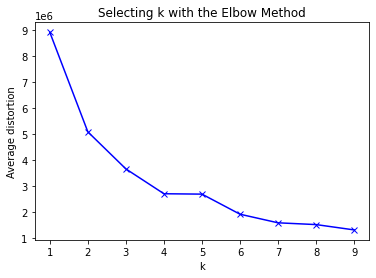

In [2017]:
#Performing KMeans Clustering for data using ohlc columns
from scipy.spatial.distance import cdist
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(data)
    prediction=model.predict(data)
    meanDistortions.append(sum(np.min(cdist(data, model.cluster_centers_, 'euclidean'), axis=1)) / data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [2018]:
#Finding out the fitted value of data with the KMeans clustering
from scipy.stats import zscore
mydata_z = data.apply(zscore)
kmeans = KMeans(n_clusters=4, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)

KMeans(n_clusters=4, n_init=15, random_state=2345)

In [2019]:
#Adding the cluster labels as another column to data
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
data = data.join(df_labels)
data["stock"] = stock_name["stock"]

In [2020]:
#Printing the centroids
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,Open,High,Low,Close,Adj Close,Volume
0,-0.491161,-0.490206,-0.492273,-0.491367,-0.489975,2.169023
1,4.302557,4.305042,4.302509,4.304784,4.337293,-0.558268
2,-0.348525,-0.348651,-0.348695,-0.348726,-0.345770,-0.220934
3,0.839504,0.838814,0.840974,0.839985,0.820579,-0.542753


In [2021]:
#Listing out the names of stocks and their proportions in each cluster
for label in range(1+np.max(list(data['labels'].values))):
    newdata = data[data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
BANKBARODA.NS    0.228504
ICICIBANK.NS     0.197880
PNB.NS           0.171967
AXISBANK.NS      0.134276
INDUSINDBK.NS    0.084806
HDFCBANK.NS      0.045936
BEL.NS           0.044759
CANBK.NS         0.030624
POWERGRID.NS     0.029446
INFY.NS          0.020024
BANKINDIA.NS     0.005889
IOB.NS           0.005889
Name: stock, dtype: float64
1
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
2
ALPHAGEO.NS      0.052952
LTTS.NS          0.052952
TORNTPOWER.NS    0.052952
IEX.NS           0.052952
ADANITRANS.NS    0.052952
SWSOLAR.NS       0.052952
KOTAKBANK.NS     0.052952
KENNAMET.NS      0.052952
TCS.NS           0.052952
BANKINDIA.NS     0.051902
IOB.NS           0.051902
INFY.NS          0.049380
LTI.NS           0.047909
POWERGRID.NS     0.047699
CANBK.NS         0.047489
BEL.NS           0.044967
HDFCBANK.NS      0.044757
INDUSINDBK.NS    0.037823
AXISBANK.NS      0.028998
PNB.NS           0.022274
ICICIBANK.NS     0.017651
BANKBARODA.NS    0.012187
ASTRAZEN.NS      0.010086
OFSS.NS

In [2022]:
#data_2 has only adj closing price
data_2 = pd.DataFrame()
data_2["Adj Close"] = data["Adj Close"]


In [2023]:
data_2.head()

,Adj Close
0,682.950012
1,678.200012
2,661.150024
3,663.900024
4,645.700012


Text(0.5, 1.0, 'Selecting k with the Elbow Method')

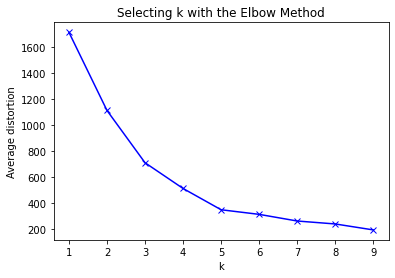

In [2024]:
#Performing KMeans clustering for data_2 using only one variable - adj close price
#from scipy.spatial.distance import cdist
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(data_2)
    prediction=model.predict(data_2)
    meanDistortions.append(sum(np.min(cdist(data_2, model.cluster_centers_, 'euclidean'), axis=1)) / data_2
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [2025]:
#Adding cluster labels to data_2 after choosing number of clusters
mydata_z = data_2.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
data_2 = data_2.join(df_labels)
data_2["stock"] = stock_name["stock"]

In [2026]:
data_2.head()

,Adj Close,labels,stock
0,682.950012,0,AXISBANK.NS
1,678.200012,0,AXISBANK.NS
2,661.150024,0,AXISBANK.NS
3,663.900024,0,AXISBANK.NS
4,645.700012,0,AXISBANK.NS


In [2027]:
#Printing the centroids
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,Adj Close
0,-0.494692
1,4.541506
2,1.935131
3,0.556660
4,-0.051897


In [2028]:
#Listing out stocks and their proportions in each cluster
for label in range(1+np.max(list(data_2['labels'].values))):
    newdata = data_2[data_2.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
ALPHAGEO.NS      0.062953
CANBK.NS         0.062953
AXISBANK.NS      0.062953
POWERGRID.NS     0.062953
BANKINDIA.NS     0.062953
IOB.NS           0.062953
BEL.NS           0.062953
BANKBARODA.NS    0.062953
PNB.NS           0.062953
ICICIBANK.NS     0.062953
TORNTPOWER.NS    0.062953
SWSOLAR.NS       0.062953
ADANITRANS.NS    0.062953
IEX.NS           0.062953
INFY.NS          0.053960
INDUSINDBK.NS    0.030227
KENNAMET.NS      0.030227
HDFCBANK.NS      0.004247
Name: stock, dtype: float64
1
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
2
SANOFI.NS        0.87108
ABBOTINDIA.NS    0.12892
Name: stock, dtype: float64
3
PFIZER.NS      0.268657
DRREDDY.NS     0.268657
ASTRAZEN.NS    0.217484
OFSS.NS        0.217484
LTI.NS         0.025586
SANOFI.NS      0.002132
Name: stock, dtype: float64
4
TCS.NS           0.156231
LTTS.NS          0.156231
KOTAKBANK.NS     0.156231
HDFCBANK.NS      0.145691
LTI.NS           0.141352
INDUSINDBK.NS    0.081215
KENNAMET.NS      0.081215
ASTRAZEN.NS  

In [2029]:
kmeans.cluster_centers_

array([[-0.4946922 ],
       [ 4.54150643],
       [ 1.93513124],
       [ 0.55666025],
       [-0.05189742]])

In [2030]:
#data_3 is the dataframe that has each row indicating a particular date and each column as a company name.
data_3 = pd.DataFrame()
time_duration = int(data.shape[0]/len(stocks))
for i in range(len(stocks)) :
    data_3[stocks[i]] = np.array(data_2.iloc[time_duration*i:time_duration+time_duration*i,0])

In [2031]:
#data_4 has columns that indicate each date and rows belonging to each stock
data_4 = data_3.transpose()
data_4.head(10)

,0,1,2,3,4,5,6,7,8,9,...,242,243,244,245,246,247,248,249,250,251
AXISBANK.NS,682.950012,678.200012,661.150024,663.900024,645.700012,647.299988,649.599976,671.099976,671.549988,681.700012,...,440.450012,445.799988,451.799988,463.350006,473.049988,509.200012,496.750000,485.700012,484.399994,474.950012
ICICIBANK.NS,418.600006,412.950012,404.399994,409.649994,392.149994,397.500000,389.000000,391.350006,395.450012,394.600006,...,371.149994,380.350006,386.350006,389.350006,392.200012,409.700012,394.600006,390.950012,392.399994,382.750000
HDFCBANK.NS,1129.969971,1123.750000,1113.469971,1113.969971,1105.469971,1123.880005,1117.569946,1122.949951,1124.800049,1125.650024,...,1085.650024,1117.050049,1119.699951,1118.449951,1112.099976,1114.500000,1115.849976,1127.300049,1134.150024,1130.900024
KOTAKBANK.NS,1501.550049,1483.650024,1450.849976,1431.449951,1414.300049,1426.449951,1410.150024,1441.550049,1471.300049,1475.199951,...,1339.400024,1387.250000,1400.099976,1436.699951,1420.000000,1467.099976,1401.349976,1430.650024,1423.500000,1396.699951
INDUSINDBK.NS,1386.099976,1365.849976,1350.550049,1395.750000,1343.949951,1317.599976,1308.099976,1331.099976,1335.000000,1372.150024,...,513.549988,529.150024,536.500000,567.650024,605.849976,665.650024,630.200012,627.450012,640.549988,631.849976
PNB.NS,67.150002,65.650002,65.050003,64.900002,59.400002,59.900002,61.099998,61.299999,62.599998,64.849998,...,35.650002,35.299999,35.200001,35.400002,35.299999,37.049999,35.049999,34.700001,34.799999,34.500000
BANKINDIA.NS,69.300003,67.699997,65.900002,65.550003,62.849998,63.849998,63.700001,63.700001,66.099998,68.150002,...,48.200001,47.900002,47.750000,48.400002,49.900002,52.549999,54.349998,52.099998,51.400002,50.549999
CANBK.NS,229.550003,226.899994,220.600006,220.600006,197.000000,192.649994,191.550003,191.699997,197.949997,204.500000,...,104.300003,103.500000,106.699997,106.300003,105.550003,114.800003,107.500000,106.750000,107.750000,106.300003
IOB.NS,10.300000,10.100000,10.000000,10.450000,10.150000,10.000000,10.050000,9.950000,9.850000,10.150000,...,11.700000,11.150000,10.850000,10.900000,10.900000,11.050000,10.600000,10.450000,10.400000,10.350000
BANKBARODA.NS,97.300003,94.500000,91.800003,92.599998,91.449997,93.300003,93.750000,94.400002,95.550003,99.050003,...,48.349998,48.349998,48.700001,48.450001,48.700001,51.599998,48.950001,47.549999,47.250000,47.299999


In [2032]:
#Applying PCA to data containing only Adjusted Close price
from sklearn.decomposition import PCA
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(data_4)
principal_data = pd.DataFrame(data = principal_comp, columns = ['principal component 1', 'principal component 2'])
principal_data['stock'] = stocks
principal_data

,principal component 1,principal component 2,stock
0,-17677.687758,546.216523,AXISBANK.NS
1,-19862.867077,-902.619752,ICICIBANK.NS
2,-9142.781233,1641.904710,HDFCBANK.NS
3,-3733.423610,2727.832360,KOTAKBANK.NS
4,-12703.722696,5577.916733,INDUSINDBK.NS
5,-25690.847686,-2366.444139,PNB.NS
6,-25572.025287,-2349.745236,BANKINDIA.NS
7,-24163.212346,-1582.457690,CANBK.NS
8,-26245.446296,-2636.866509,IOB.NS
9,-25323.366874,-2199.560491,BANKBARODA.NS


In [2033]:
#Dropping stock name column so as to run KMeans algorithm
principal_data.drop(columns='stock',axis=1,inplace=True)

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

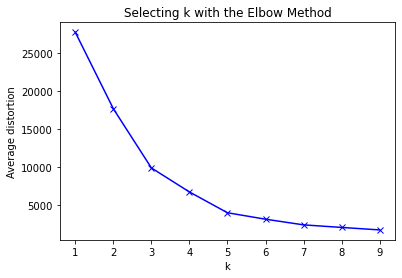

In [2034]:
#clustering the principal data based on 2 principal components
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(principal_data)
    prediction=model.predict(principal_data)
    meanDistortions.append(sum(np.min(cdist(principal_data, model.cluster_centers_, 'euclidean'), axis=1)) / principal_data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [2035]:
mydata_z = principal_data.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
principal_data = mydata_z.join(df_labels)
principal_data['stock'] = stocks
principal_data

,principal component 1,principal component 2,labels,stock
0,-0.391800,0.204503,1,AXISBANK.NS
1,-0.440232,-0.337939,0,ICICIBANK.NS
2,-0.202637,0.614727,1,HDFCBANK.NS
3,-0.082746,1.021296,1,KOTAKBANK.NS
4,-0.281560,2.088364,4,INDUSINDBK.NS
5,-0.569401,-0.885993,0,PNB.NS
6,-0.566767,-0.879741,0,BANKINDIA.NS
7,-0.535543,-0.592470,0,CANBK.NS
8,-0.581693,-0.987239,0,IOB.NS
9,-0.561256,-0.823512,0,BANKBARODA.NS


In [2036]:
#Centroids Data
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,principal component 1,principal component 2
0,-0.437933,-0.660409
1,0.035564,0.626820
2,4.396242,-1.717452
3,1.808532,1.332217
4,0.022069,2.324990


<Figure size 432x288 with 0 Axes>

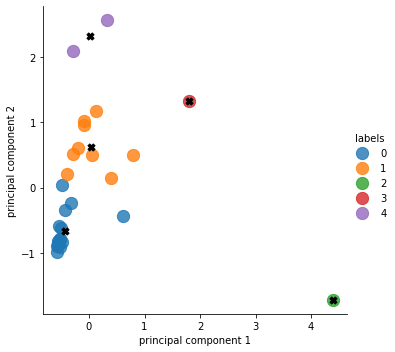

In [2037]:
#Clustering based on principal components and only adjusted close price
plt.figure()
facet = sns.lmplot(data=principal_data, x='principal component 1', y='principal component 2', hue='labels', 
                   fit_reg=False, legend=True, legend_out=True,scatter_kws={"s": 150})
for i in range(len(centroid_df)) :
    plt.scatter(centroid_df.iloc[i]['principal component 1'],centroid_df.iloc[i]['principal component 2'],marker='X',c='black',s=50)

In [2038]:
#Above shown cluster represented as list data
for label in range(1+np.max(list(principal_data['labels'].values))):
    newdata = principal_data[principal_data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
IOB.NS           0.066667
SWSOLAR.NS       0.066667
BANKBARODA.NS    0.066667
PNB.NS           0.066667
IEX.NS           0.066667
CANBK.NS         0.066667
POWERGRID.NS     0.066667
BANKINDIA.NS     0.066667
TORNTPOWER.NS    0.066667
BEL.NS           0.066667
ADANITRANS.NS    0.066667
ALPHAGEO.NS      0.066667
DRREDDY.NS       0.066667
ICICIBANK.NS     0.066667
INFY.NS          0.066667
Name: stock, dtype: float64
1
ASTRAZEN.NS     0.111111
HDFCBANK.NS     0.111111
TCS.NS          0.111111
KENNAMET.NS     0.111111
LTTS.NS         0.111111
PFIZER.NS       0.111111
KOTAKBANK.NS    0.111111
AXISBANK.NS     0.111111
LTI.NS          0.111111
Name: stock, dtype: float64
2
ABBOTINDIA.NS    1.0
Name: stock, dtype: float64
3
SANOFI.NS    1.0
Name: stock, dtype: float64
4
INDUSINDBK.NS    0.5
OFSS.NS          0.5
Name: stock, dtype: float64


In [2039]:
#pct_data contains the columns as each stock name and rows as dates with each value holding the percent change in adj close price
pct_data = data_3.pct_change().drop(index=0,axis=0)

In [2040]:
pct_data = pct_data.transpose()

In [2041]:
pct_data

,1,2,3,4,5,6,7,8,9,10,...,242,243,244,245,246,247,248,249,250,251
AXISBANK.NS,-0.006955,-0.025140,0.004159,-0.027414,0.002478,0.003553,0.033097,0.000671,0.015114,-0.027578,...,0.012645,0.012147,0.013459,0.025564,0.020934,0.076419,-0.024450,-0.022245,-0.002677,-0.019509
ICICIBANK.NS,-0.013497,-0.020705,0.012982,-0.042719,0.013643,-0.021384,0.006041,0.010477,-0.002149,0.020527,...,0.009245,0.024788,0.015775,0.007765,0.007320,0.044620,-0.036856,-0.009250,0.003709,-0.024592
HDFCBANK.NS,-0.005505,-0.009148,0.000449,-0.007630,0.016654,-0.005615,0.004814,0.001648,0.000756,0.008688,...,0.025165,0.028923,0.002372,-0.001116,-0.005677,0.002158,0.001211,0.010261,0.006076,-0.002866
KOTAKBANK.NS,-0.011921,-0.022108,-0.013371,-0.011981,0.008591,-0.011427,0.022267,0.020638,0.002651,-0.011964,...,0.000785,0.035725,0.009263,0.026141,-0.011624,0.033169,-0.044816,0.020908,-0.004998,-0.018827
INDUSINDBK.NS,-0.014609,-0.011202,0.033468,-0.037113,-0.019606,-0.007210,0.017583,0.002930,0.027828,0.013191,...,0.000292,0.030377,0.013890,0.058062,0.067295,0.098704,-0.053256,-0.004364,0.020878,-0.013582
PNB.NS,-0.022338,-0.009139,-0.002306,-0.084746,0.008418,0.020033,0.003273,0.021207,0.035942,-0.004626,...,0.015670,-0.009818,-0.002833,0.005682,-0.002825,0.049575,-0.053981,-0.009986,0.002882,-0.008621
BANKINDIA.NS,-0.023088,-0.026588,-0.005311,-0.041190,0.015911,-0.002349,0.000000,0.037677,0.031014,0.001467,...,0.004167,-0.006224,-0.003132,0.013613,0.030992,0.053106,0.034253,-0.041398,-0.013436,-0.016537
CANBK.NS,-0.011544,-0.027765,0.000000,-0.106981,-0.022081,-0.005710,0.000783,0.032603,0.033089,-0.004890,...,0.002885,-0.007670,0.030918,-0.003749,-0.007056,0.087636,-0.063589,-0.006977,0.009368,-0.013457
IOB.NS,-0.019417,-0.009901,0.045000,-0.028708,-0.014778,0.005000,-0.009950,-0.010050,0.030457,-0.014778,...,0.026316,-0.047009,-0.026906,0.004608,0.000000,0.013762,-0.040724,-0.014151,-0.004785,-0.004808
BANKBARODA.NS,-0.028777,-0.028571,0.008715,-0.012419,0.020230,0.004823,0.006933,0.012182,0.036630,0.020697,...,0.018967,0.000000,0.007239,-0.005133,0.005160,0.059548,-0.051357,-0.028601,-0.006309,0.001058


In [2042]:
#Applying PCA to percentage change of adj close price data
pca = PCA(n_components=2)
principal_comp = pca.fit_transform(pct_data)
pct_data = pd.DataFrame(data = principal_comp, columns = ['principal component 1', 'principal component 2'])

Text(0.5, 1.0, 'Selecting k with the Elbow Method')

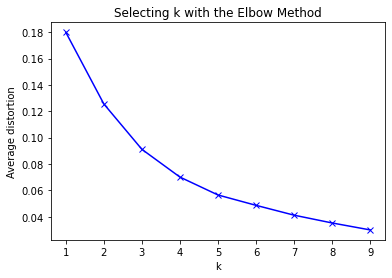

In [2043]:
#clustering pct data 
clusters=range(1,10)
meanDistortions=[]

for k in clusters:
    model=KMeans(n_clusters=k)
    model.fit(pct_data)
    prediction=model.predict(pct_data)
    meanDistortions.append(sum(np.min(cdist(pct_data, model.cluster_centers_, 'euclidean'), axis=1)) / pct_data
                           .shape[0])


plt.plot(clusters, meanDistortions, 'bx-')
plt.xlabel('k')
plt.ylabel('Average distortion')
plt.title('Selecting k with the Elbow Method')

In [2044]:
mydata_z = pct_data.apply(zscore)
kmeans = KMeans(n_clusters=5, n_init = 15, random_state=2345)
kmeans.fit(mydata_z)
df_labels = pd.DataFrame(kmeans.labels_ , columns = list(['labels']))
df_labels['labels'] = df_labels['labels'].astype('category')
pct_data = mydata_z.join(df_labels)
pct_data['stock'] = stocks

In [2045]:
pct_data.head()

,principal component 1,principal component 2,labels,stock
0,1.833981,0.107161,3,AXISBANK.NS
1,1.246159,0.127180,3,ICICIBANK.NS
2,0.475488,-0.037000,3,HDFCBANK.NS
3,0.543151,-0.434486,3,KOTAKBANK.NS
4,3.892653,-1.318456,2,INDUSINDBK.NS


In [2046]:
#Centroids Data
centroids = kmeans.cluster_centers_
centroid_df = pd.DataFrame(centroids, columns = list(mydata_z) )
centroid_df

,principal component 1,principal component 2
0,0.289810,1.683109
1,-0.510455,-0.763383
2,3.892653,-1.318456
3,1.024695,-0.059287
4,-0.560914,0.612808


<Figure size 432x288 with 0 Axes>

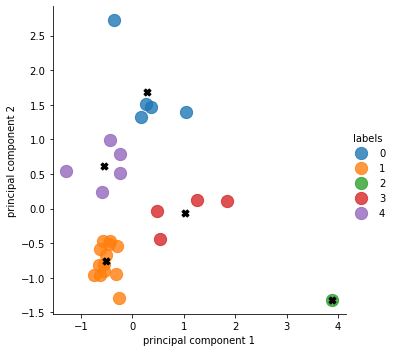

In [2047]:
#Clusters plot
plt.figure()
facet = sns.lmplot(data=pct_data, x='principal component 1', y='principal component 2', hue='labels', 
                   fit_reg=False, legend=True, legend_out=True,scatter_kws={"s": 150})
for i in range(len(centroid_df)) :
    plt.scatter(centroid_df.iloc[i]['principal component 1'],centroid_df.iloc[i]['principal component 2'],marker='X',c='black',s=50)

In [2048]:
#Above shown clusters represented in list form
for label in range(1+np.max(list(pct_data['labels'].values))):
    newdata = pct_data[pct_data.labels == label]
    print(label)
    print(newdata['stock'].value_counts(normalize=True))

0
BANKBARODA.NS    0.2
PNB.NS           0.2
CANBK.NS         0.2
ALPHAGEO.NS      0.2
BANKINDIA.NS     0.2
Name: stock, dtype: float64
1
ASTRAZEN.NS      0.076923
TCS.NS           0.076923
LTTS.NS          0.076923
PFIZER.NS        0.076923
SANOFI.NS        0.076923
LTI.NS           0.076923
POWERGRID.NS     0.076923
OFSS.NS          0.076923
TORNTPOWER.NS    0.076923
KENNAMET.NS      0.076923
ABBOTINDIA.NS    0.076923
DRREDDY.NS       0.076923
INFY.NS          0.076923
Name: stock, dtype: float64
2
INDUSINDBK.NS    1.0
Name: stock, dtype: float64
3
KOTAKBANK.NS    0.25
AXISBANK.NS     0.25
HDFCBANK.NS     0.25
ICICIBANK.NS    0.25
Name: stock, dtype: float64
4
BEL.NS           0.2
IEX.NS           0.2
ADANITRANS.NS    0.2
SWSOLAR.NS       0.2
IOB.NS           0.2
Name: stock, dtype: float64


In [2049]:
#Preparing a percentage change data for Effective Frontier Analysis
data_3 = data_3.pct_change()
data_3.drop(index=0,axis=0,inplace=True)
data_3

,AXISBANK.NS,ICICIBANK.NS,HDFCBANK.NS,KOTAKBANK.NS,INDUSINDBK.NS,PNB.NS,BANKINDIA.NS,CANBK.NS,IOB.NS,BANKBARODA.NS,...,ALPHAGEO.NS,POWERGRID.NS,TORNTPOWER.NS,SWSOLAR.NS,ADANITRANS.NS,IEX.NS,INFY.NS,LTI.NS,OFSS.NS,TCS.NS
1,-0.006955,-0.013497,-0.005505,-0.011921,-0.014609,-0.022338,-0.023088,-0.011544,-0.019417,-0.028777,...,-0.021314,-0.003873,-0.008823,-0.021804,-0.006559,-0.024815,0.022749,-0.002251,-0.001412,0.001229
2,-0.025140,-0.020705,-0.009148,-0.022108,-0.011202,-0.009139,-0.026588,-0.027765,-0.009901,-0.028571,...,0.025829,-0.004617,-0.013886,-0.009986,0.005751,0.001899,0.005545,-0.005092,-0.005172,-0.002590
3,0.004159,0.012982,0.000449,-0.013371,0.033468,-0.002306,-0.005311,0.000000,0.045000,0.008715,...,0.038756,-0.020996,0.003791,-0.015736,-0.008259,0.020470,0.009852,-0.003095,0.030125,0.011708
4,-0.027414,-0.042719,-0.007630,-0.011981,-0.037113,-0.084746,-0.041190,-0.106981,-0.028708,-0.012419,...,-0.024953,-0.017207,-0.017086,-0.058949,0.002990,-0.002600,-0.000798,-0.010637,-0.008747,-0.003540
5,0.002478,0.013643,0.016654,0.008591,-0.019606,0.008418,0.015911,-0.022081,-0.014778,0.020230,...,-0.020229,-0.000761,-0.009698,-0.009322,0.005110,0.002607,0.008658,0.023553,0.002521,-0.002754
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
247,0.076419,0.044620,0.002158,0.033169,0.098704,0.049575,0.053106,0.087636,0.013762,0.059548,...,-0.005665,-0.015659,0.001453,-0.019041,-0.008632,0.007315,-0.012460,0.009111,-0.002656,-0.004381
248,-0.024450,-0.036856,0.001211,-0.044816,-0.053256,-0.053981,0.034253,-0.063589,-0.040724,-0.051357,...,-0.068096,-0.018376,-0.033952,-0.056551,-0.081081,0.000259,-0.007110,-0.024309,-0.003156,0.008354
249,-0.022245,-0.009250,0.010261,0.020908,-0.004364,-0.009986,-0.041398,-0.006977,-0.014151,-0.028601,...,-0.010480,0.008103,0.023881,0.002770,0.040268,-0.004148,-0.015561,0.005410,-0.020049,-0.004829
250,-0.002677,0.003709,0.006076,-0.004998,0.020878,0.002882,-0.013436,0.009368,-0.004785,-0.006309,...,0.006178,0.027444,0.000147,0.008877,0.044592,0.004947,0.010775,0.003055,-0.003988,0.008369


In [2050]:
#Effective Frontier Analysis - Choosing the best stock from each sector based on the risk adjusted return
fixed_rate = 3.59/100
annual_return = []
final_stock = []
volatility = []

risk_return = []
for p in pharma:
    risk_return.append(((np.mean(data_3[p])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[p]))
p = risk_return.index(np.max(risk_return))
final_stock.append(pharma[p])
annual_return.append((np.mean(data_3[pharma[p]])+1)**time_duration - 1)
volatility.append(np.std(data_3[pharma[p]])*np.sqrt(time_duration))

risk_return = []
for e in engg:
    risk_return.append(((np.mean(data_3[e])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[e]))
e = risk_return.index(np.max(risk_return))
final_stock.append(engg[e])
annual_return.append((np.mean(data_3[engg[e]])+1)**time_duration - 1)
volatility.append(np.std(data_3[engg[e]])*np.sqrt(time_duration))

risk_return = []
for p in power:
    risk_return.append(((np.mean(data_3[p])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[p]))
p = risk_return.index(np.max(risk_return))
final_stock.append(power[p])
annual_return.append((np.mean(data_3[power[p]])+1)**time_duration - 1)
volatility.append(np.std(data_3[power[p]])*np.sqrt(time_duration))

sample_return = []
risk_return = []
for i in IT:
    risk_return.append(((np.mean(data_3[i])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[i]))
    sample_return.append((np.mean(data_3[i])+1)**time_duration - 1)
i = risk_return.index(np.max(risk_return))
final_stock.append(IT[i])
annual_return.append((np.mean(data_3[IT[i]])+1)**time_duration - 1)
volatility.append(np.std(data_3[IT[i]])*np.sqrt(time_duration))

risk_return = []
for b in bank:
    risk_return.append(((np.mean(data_3[b])+1)**time_duration - 1 - fixed_rate)/np.std(data_3[b]))
b = risk_return.index(np.max(risk_return))
final_stock.append(bank[b])
annual_return.append((np.mean(data_3[bank[b]])+1)**time_duration - 1)
volatility.append(np.std(data_3[bank[b]])*np.sqrt(time_duration))

choosen_data = pd.DataFrame()
choosen_data['stock'] = final_stock
choosen_data['annual return'] = annual_return
choosen_data['volatility'] = volatility
choosen_data


,stock,annual return,volatility
0,ABBOTINDIA.NS,0.957724,0.363887
1,BEL.NS,0.211421,0.506724
2,IEX.NS,0.628180,0.447161
3,LTI.NS,0.656023,0.380558
4,IOB.NS,0.130042,0.491558


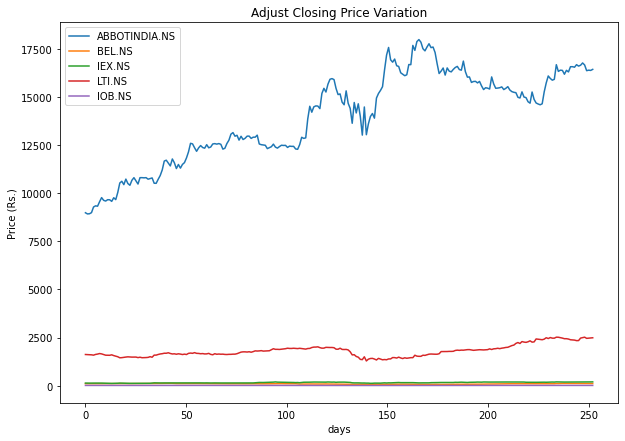

In [2051]:
#Stocks Analysis - Adj Close price variation
plt.figure(figsize=(10, 7))
for stk in choosen_data['stock']:
    plt.plot(np.linspace(start=0,stop=time_duration,num=len(data_2[data_2.stock==stk])),data_2[data_2.stock==stk]['Adj Close'],label=stk)
plt.xlabel('days')
plt.ylabel('Price (Rs.)')
plt.title('Adjust Closing Price Variation')
plt.legend()

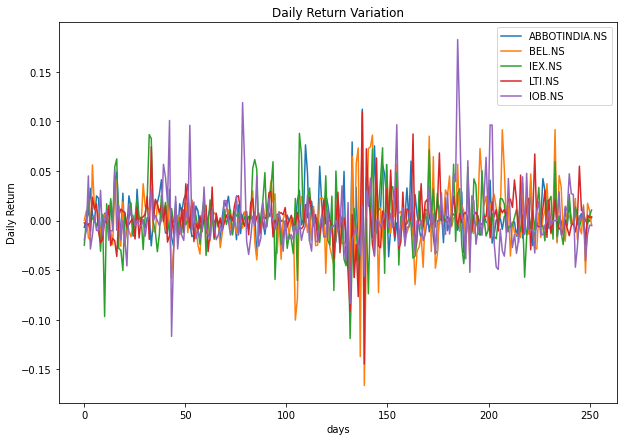

In [2052]:
#Stocks Analysis - Daily Return
plt.figure(figsize=(10, 7))
for stk in choosen_data['stock']:
    plt.plot(np.linspace(start=0,stop=time_duration-1,num=len(data_3)),data_3[stk],label=stk)
plt.xlabel('days')
plt.ylabel('Daily Return')
plt.title('Daily Return Variation')
plt.legend()

In [2053]:
#Getting the covariance matrix
cov_data = pd.DataFrame(data=data_3,columns=final_stock)
cov_data = cov_data.transpose()
#print(cov_data.shape)
cov_data = np.cov(cov_data)
print(cov_data*(time_duration))

[[0.13294354 0.06102029 0.01598129 0.03967841 0.0250393 ]
 [0.06102029 0.25779677 0.05296085 0.05131212 0.07006027]
 [0.01598129 0.05296085 0.20075279 0.02625466 0.05303446]
 [0.03967841 0.05131212 0.02625466 0.14540342 0.03069341]
 [0.0250393  0.07006027 0.05303446 0.03069341 0.24259585]]


In [2054]:
#Random Portfolio Generation
fixed_rate = 3.59/100
sharpe_ratio = []
weights_record = []
ret_record = []
vol_record = []
for i in range(200000) :
    weights = np.random.random(len(choosen_data))
    weights /= np.sum(weights)
    ret = weights.dot(annual_return)
    std = np.sqrt(time_duration)*(weights.dot(cov_data.dot(weights.transpose())))**0.5
    sharpe_ratio.append((ret-fixed_rate)/std)
    weights_record.append(weights)
    ret_record.append(ret)
    vol_record.append(std)
    
complete_portfolio = pd.DataFrame()
complete_portfolio['sharpe ratio'] = sharpe_ratio
complete_portfolio['return'] = ret_record
complete_portfolio['volatility'] = vol_record
#print(ret_record)
#print(vol_record)

In [2055]:
#minimum volatility portfolio
portfolio = pd.DataFrame()
index = vol_record.index(np.min(vol_record))
portfolio['weights'] = weights_record[index]
portfolio['stock'] = final_stock
minvol_ret = ret_record[index]
minvol_vol = vol_record[index]
portfolio

,weights,stock
0,0.340986,ABBOTINDIA.NS
1,0.022251,BEL.NS
2,0.212636,IEX.NS
3,0.280674,LTI.NS
4,0.143453,IOB.NS


In [2056]:
#max sharpe ratio/risk adjusted return portfolio
portfolio = pd.DataFrame()
index = sharpe_ratio.index(np.max(sharpe_ratio))
portfolio['weights'] = weights_record[index]
portfolio['stock'] = final_stock
maxsharpe_ret = ret_record[index]
maxsharpe_vol = vol_record[index]
portfolio

,weights,stock
0,0.569499,ABBOTINDIA.NS
1,0.006955,BEL.NS
2,0.169564,IEX.NS
3,0.253662,LTI.NS
4,0.000321,IOB.NS


In [2057]:
#Obtaining the effective frontier line
frontier_ret = [minvol_ret]
frontier_vol = [minvol_vol]
for i in np.linspace(start=minvol_vol,stop=maxsharpe_vol,num=50):
    frontier_data = complete_portfolio[(complete_portfolio.volatility < i+0.001) & (complete_portfolio.volatility > i-0.001)]
    index = list(frontier_data['sharpe ratio']).index(np.max(frontier_data['sharpe ratio']))
    f_ret = list(frontier_data['return'])[index]
    f_vol = list(frontier_data['volatility'])[index]
    frontier_ret.append(f_ret)
    frontier_vol.append(f_vol)
frontier_ret.append(np.max(annual_return))
frontier_vol.append(volatility[annual_return.index(np.max(annual_return))])

In [2063]:
#Performing a polynomial fit on the effective frontier
z = np.polyfit(frontier_vol,frontier_ret,6)
fit_ret = []
for vol in frontier_vol :
    new_ret = 0
    for i in range(len(z)) :
        new_ret += z[i]*(vol**(len(z)-i-1))
    fit_ret.append(new_ret)

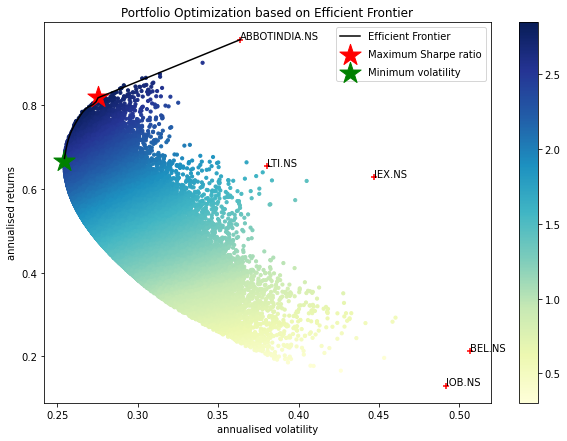

In [2059]:
#Plotting Portfolio results along with efficient frontier
plt.figure(figsize=(10, 7))
plt.scatter(vol_record,ret_record,c=sharpe_ratio,cmap='YlGnBu',s=10)
plt.colorbar()
plt.plot(frontier_vol,fit_ret,linestyle='-',color='black',label='Efficient Frontier')
plt.scatter(maxsharpe_vol,maxsharpe_ret,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
plt.scatter(minvol_vol,minvol_ret,marker='*',color='g',s=500, label='Minimum volatility')
plt.scatter(volatility,annual_return,marker='+',color='r')
for i, txt in enumerate(final_stock):
    plt.annotate(txt, (volatility[i], annual_return[i]))
plt.title('Portfolio Optimization based on Efficient Frontier')
plt.xlabel('annualised volatility')
plt.ylabel('annualised returns')
plt.legend(labelspacing=0.8)

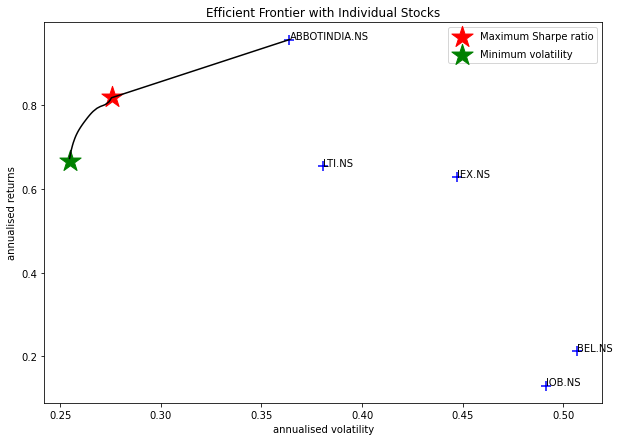

In [2061]:
#Plotting Efficient Frontier with individual stocks
plt.figure(figsize=(10, 7))
plt.plot(frontier_vol,fit_ret,linestyle='-',color='black')
plt.scatter(maxsharpe_vol,maxsharpe_ret,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
plt.scatter(minvol_vol,minvol_ret,marker='*',color='g',s=500, label='Minimum volatility')
plt.scatter(volatility,annual_return,marker='+',color='b',s=100)
for i, txt in enumerate(final_stock):
    plt.annotate(txt, (volatility[i], annual_return[i]))
plt.title('Efficient Frontier with Individual Stocks')
plt.xlabel('annualised volatility')
plt.ylabel('annualised returns')
plt.legend(labelspacing=0.8)